# **Data Cleaning**

In [15]:
cardioData.isnull().values.any()

False

*While browsing through the data, we noticed that there were several discrepencies in the systolic and diatolic blood pressures. There were negative values of blood pressure which is unrealistic. In addition to that, there are additional cases where Diastolic pressure is higher than systolic pressure and this is considered an abnormal case which we should remove from the dataset*

In [16]:
#create dataframe with initial Diastolic and Systolic blood pressure levels
blood_pressure = cardioData[['ap_lo', 'ap_hi']]

blood_pressure = blood_pressure.melt(var_name='variable', value_name='value')

fig = px.box(blood_pressure, x='variable', y='value', color='variable', title='Initial Blood Pressure')
fig.show()

# Print the number of cases where diastolic pressure is higher than systolic pressure
num_cases = cardioData[cardioData['ap_lo'] > cardioData['ap_hi']].shape[0]
print("Diastolic pressure is higher than systolic one in {0} cases".format(num_cases))

Diastolic pressure is higher than systolic one in 1234 cases


*The same is done for the height and weight variables. These variables too contain rather unnatural abnormality values such as the minimum weight in the dataset to be 10.*

In [17]:
height_weight = cardioData[['height','weight']]

height_weight = height_weight.melt(var_name='variable', value_name='value')

fig = px.box(height_weight, x='variable', y='value', color='variable', title='Initial Height & Weight')
fig.show()

## Create New Variable (BMI)
*With the given values of height and weight in the dataset, we created another variable BMI as we believe it may be of relevance when it comes to CVD detection later on when we create our Machine Learning Model.* 
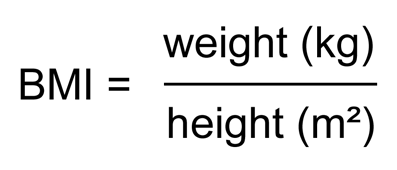

## Remove outliers
*We then did data cleaning on the 6 relevant numeric variables, Age, Weight, Height, Systolic & Diastolic blood pressure and BMI*

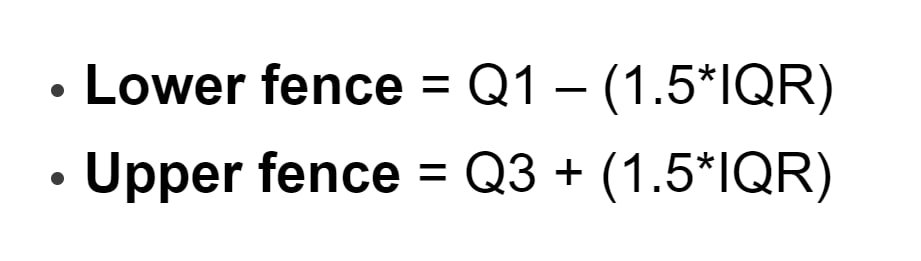
*We utilized the upper and lower fences representation in statistics to cut-off values for upper and lower outliers of the 6 numeric variables in the dataset.*

In [18]:
def addBMI(rawData):
    rawData['BMI']=rawData['weight']/(rawData['height']/100)**2
    return rawData
def dataCleaning(rawData):
    #remove rows that contain Negative value for ap_hi and ap_lo
    rawData =rawData.drop(rawData[rawData.ap_hi<0].index)
    rawData =rawData.drop(rawData[rawData.ap_lo<50].index)
    
    #remove rows that contain extreme high values for ap_hi 
    rawData =rawData.drop(rawData[rawData.ap_hi>300].index)
    
    outliers=[]
    #loop the whole dataset
    for rawColumn in rawData:
        if(rawColumn=='age'or rawColumn=='weight'or rawColumn=='height'or rawColumn=='ap_hi'or rawColumn=='ap_lo' or rawColumn=='BMI'):
            #set a top limit and bottom limit for column that need to change
            q1=rawData[rawColumn].describe()[4]
            q3=rawData[rawColumn].describe()[6]
            iqr=q3-q1
            topLimit=q3+1.5*iqr
            bottomLimit=q1-1.5*iqr
            
            #select outliers with conditions
            outliers=rawData[(rawData[rawColumn]>topLimit) | (rawData[rawColumn]<bottomLimit)] 
            
            #drop the outliers
            rawData=rawData.drop(rawData[rawData.id.isin(outliers['id'])].index)
            
            #select outliers if ap_lo > ap_hi
            if(rawColumn=='ap_lo'):
                outliers=rawData[(rawData[rawColumn]>rawData['ap_hi'])]
                #drop the outliers
                rawData=rawData.drop(rawData[rawData.id.isin(outliers['id'])].index)
            
    
    
    return rawData

cardioData=addBMI(cardioData)
cardioData=dataCleaning(cardioData)        
print(cardioData)

          id    age  gender  height  weight  ap_hi  ap_lo        cholesterol  \
0          0  18393    male     168    62.0    110     80             normal   
1          1  20228  female     156    85.0    140     90  well above normal   
2          2  18857  female     165    64.0    130     70  well above normal   
3          3  17623    male     169    82.0    150    100             normal   
5          8  21914  female     151    67.0    120     80       above normal   
...      ...    ...     ...     ...     ...    ...    ...                ...   
69993  99991  19699  female     172    70.0    130     90             normal   
69994  99992  21074  female     165    80.0    150     80             normal   
69995  99993  19240    male     168    76.0    120     80             normal   
69998  99998  22431  female     163    72.0    135     80             normal   
69999  99999  20540  female     170    72.0    120     80       above normal   

                gluc smoke alco active 

In [31]:
#Create new dataframe with Diastolic and Systolic blood pressure levels post data cleaning
blood_pressureNew = cardioData[['ap_lo', 'ap_hi']]

blood_pressureNew = blood_pressureNew.melt(var_name='variable', value_name='value')

fig = px.box(blood_pressureNew, x='variable', y='value', color='variable',
             title='Blood Pressure (Post Data Cleaning)')
#fig.show()

# Print the number of cases where diastolic pressure is higher than systolic pressure
num_cases = cardioData[cardioData['ap_lo'] > cardioData['ap_hi']].shape[0]
print("Diastolic pressure is higher than systolic one in {0} cases".format(num_cases))

Diastolic pressure is higher than systolic one in 0 cases


In [32]:
height_weightnew = cardioData[['height','weight']]

height_weightnew = height_weightnew.melt(var_name='variable', value_name='value')

fig = px.box(height_weightnew, x='variable', y='value', color='variable', title='Height & Weight (Post Data Cleaning)')
#fig.show()

In [21]:
bmiData = cardioData[['BMI']]

bmiData = bmiData.melt(var_name='variable', value_name='value')

fig = px.box(bmiData, x='variable', y='value', color='variable', title='BMI (Post Data Cleaning)')
fig.show()

## Create new Categorial Variable (Blood Pressure Category)
*We categorized the blood pressure stages based according to the systolic and diastolic pressure values*
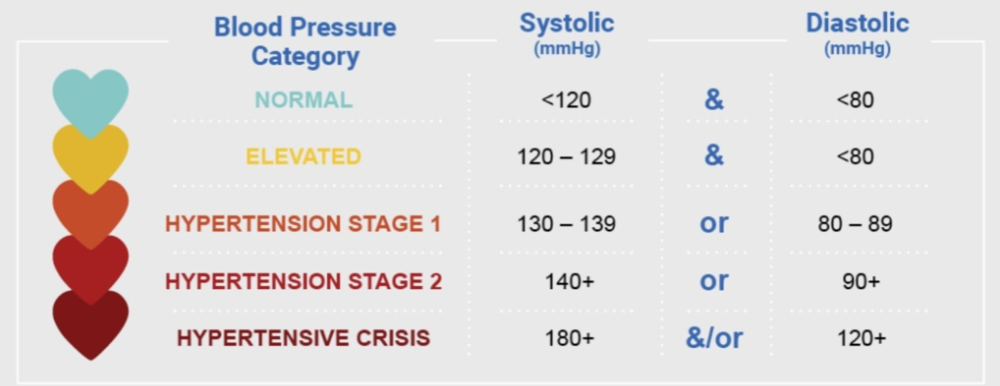
*We create a function that inserts a column BP_cat (Blood Pressure Category). This function scans 2 columns, ap_hi and ap_lo. Based on the values of these columns, it categorizes the patients blood pressure accordingly*

In [22]:
def BPcat(x,y):
    if (x<120) and (y<80):
        return 'normal'
    elif (x<130) and (y<80):
        return 'elevated'
    elif (x<140) or (y<90):
        return 'hypertension S1'
    elif (x>=140) or (y>=90):
        return 'hypertension S2'
    elif (x>180) or (y>=120):
        return 'PASSAWAY'
    else:
        return None

cardioData.insert(7, "bp_cat", cardioData.apply(lambda row: BPcat(row['ap_hi'],row['ap_lo']), axis=1))
cardioData['bp_cat'].value_counts()

hypertension S1    39701
hypertension S2    11890
normal              7186
elevated            2550
Name: bp_cat, dtype: int64

## Create New Variable (MAP)
*We included **mean arterial pressure** (MAP) aswell which is used to determine overall blood pressure. The formula is as follows*
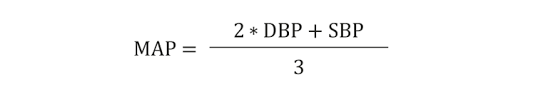

In [23]:
cardioData['MAP'] = ((2*cardioData['ap_lo'])+cardioData['ap_hi'])/3
#Reorder Columns
cardioData = cardioData[['age','age(years)','height','weight','BMI','ap_hi','ap_lo','MAP','gender',
                        'bp_cat', 'cholesterol','gluc','smoke','alco','active','cardio']]
cardioData.head()

,age,age(years),height,weight,BMI,ap_hi,ap_lo,MAP,gender,bp_cat,cholesterol,gluc,smoke,alco,active,cardio
0,18393,50,168,62.0,21.967120,110,80,90.000000,male,hypertension S1,normal,normal,no,no,yes,no
1,20228,55,156,85.0,34.927679,140,90,106.666667,female,hypertension S2,well above normal,normal,no,no,yes,yes
2,18857,52,165,64.0,23.507805,130,70,90.000000,female,hypertension S1,well above normal,normal,no,no,no,yes
3,17623,48,169,82.0,28.710479,150,100,116.666667,male,hypertension S2,normal,normal,no,no,yes,yes
5,21914,60,151,67.0,29.384676,120,80,93.333333,female,hypertension S1,above normal,above average,no,no,no,no


**Finally, we are finished with cleaning and sorting of the dataset according to our needs**

**Visualization of Variables**


In [25]:
fig = px.box(cardioData, x="cardio", y="age(years)", 
             title='.',
             color_discrete_sequence=['#1f77b4', '#ff7f0e'])
fig.show()

*It would appear that majority of the people in the data set who have CVD tend to be past the age of 50. This plot also indicates that there would be likely a higher chance of someone having CVD based on their age*